# Setup

## Install Detectron2

In [3]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
# !git clone 'https://github.com/facebookresearch/detectron2'
# dist = distutils.core.run_setup("./detectron2/setup.py")
# !python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
# sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 274 kB 6.0 MB/s eta 0:00:01
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44074 sha256=a0162cde45f73d7305e2408a8fa067ac4ed5818a8ada5f90e959341c02cf6013
  Stored in directory: /home/shabanza/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.7.0 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-jy_m91rt
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-jy_m91rt
  Installing b

In [1]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Mon_May__3_19:15:13_PDT_2021
Cuda compilation tools, release 11.3, V11.3.109
Build cuda_11.3.r11.3/compiler.29920130_0
torch:  1.10 ; cuda:  cu113
detectron2: 0.6


## Install Mask2Former

In [2]:
# clone and install Mask2Former
# !git clone https://github.com/facebookresearch/Mask2Former.git
%cd Mask2Former
%pip install -U opencv-python
# %pip install git+https://github.com/cocodataset/panopticapi.git
%pip install -r requirements.txt
%cd mask2former/modeling/pixel_decoder/ops
!python setup.py build install

/scratch/shabanza/segmentation/Mask2Former
Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 61.7 MB 6.4 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 2.3 MB 6.3 MB/s eta 0:00:01
     |████████████████████████████████| 2.2 MB 107.8 MB/s eta 0:00:01
     |████████████████████████████████| 73 kB 8.9 MB/s s eta 0:00:01
     |████████████████████████████████| 1.3 MB 103.8 MB/s eta 0:00:01
     |████████████████████████████████| 268 kB 96.8 MB/s eta 0:00:01
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  NOTE: The current PATH contains path(s) starting with `~`, which may not be expanded by all applications.
Note: you may need to restart the kernel to use updated packages.
/scratch/shabanza/segmentation

In [3]:
%cd /scratch/shabanza/segmentation/Mask2Former
%cd mask2former/modeling/pixel_decoder/ops
!sudo sh make.sh
%cd /scratch/shabanza/segmentation/Mask2Former

/scratch/shabanza/segmentation/Mask2Former
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops
running build
running build_py
running build_ext
building 'MultiScaleDeformableAttention' extension
Emitting ninja build file /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/build.ninja...
Compiling objects...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
ninja: no work to do.
g++ -pthread -shared -B /opt/conda/compiler_compat -L/opt/conda/lib -Wl,-rpath=/opt/conda/lib -Wl,--no-as-needed -Wl,--sysroot=/ /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/src/vision.o /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segment

## Imports

In [1]:
# import some common libraries
import os
import cv2
import json
import torch
import random
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image, ImageDraw
from IPython.display import display
from IPython.display import Image as dis_image

from detectron2.utils.visualizer import Visualizer

In [2]:
torch.cuda.empty_cache()

In [66]:
# You may need to restart your runtime prior to this, to let your installation take effect
%cd Mask2Former
# Some basic setup:
# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()
setup_logger(name="mask2former")


# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.projects.deeplab import add_deeplab_config
coco_metadata = MetadataCatalog.get("coco_2017_val_panoptic")

# import Mask2Former project
from mask2former import add_maskformer2_config

[Errno 2] No such file or directory: 'Mask2Former'
/scratch/shabanza/segmentation/Mask2Former


# Model

In [68]:
cfg = get_cfg()
add_deeplab_config(cfg)
add_maskformer2_config(cfg)
cfg.merge_from_file("configs/coco/instance-segmentation/swin/maskformer2_swin_large_IN21k_384_bs16_100ep.yaml")
cfg.MODEL.WEIGHTS = 'https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl'

cfg.MODEL.MASK_FORMER.TEST.SEMANTIC_ON = True
cfg.MODEL.MASK_FORMER.TEST.INSTANCE_ON = True
cfg.MODEL.MASK_FORMER.TEST.PANOPTIC_ON = True
predictor = DefaultPredictor(cfg)

[08/08 08:56:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl ...
WARNING [08/08 08:56:19 mask2former.modeling.transformer_decoder.mask2former_transformer_decoder]: Weight format of MultiScaleMaskedTransformerDecoder have changed! Please upgrade your models. Applying automatic conversion now ...


# Dataset

## Add colors to the COCO instances format

In [8]:
sinergia_coco_dir = "/sinergia/shabanza/datasets/sinergia"
sinergia_img_dir = "/sinergia/shabanza/datasets/sinergia/images/default"
sinergia_instances_coco_path = os.path.join(sinergia_coco_dir, "coco", "annotations", "instances_default.json")

In [9]:
f = open(sinergia_instances_coco_path, 'r')
sinergia_instances = json.load(f)
f.close()

In [21]:
sinergia_instances['categories']

[{'id': 1, 'name': 'Generic Object', 'supercategory': ''},
 {'id': 2, 'name': 'Car', 'supercategory': ''},
 {'id': 3, 'name': 'Bus', 'supercategory': ''},
 {'id': 4, 'name': 'Bicycle', 'supercategory': ''},
 {'id': 5, 'name': 'Motorbike', 'supercategory': ''},
 {'id': 6, 'name': 'Airplane', 'supercategory': ''},
 {'id': 7, 'name': 'Boat', 'supercategory': ''},
 {'id': 8, 'name': 'Train', 'supercategory': ''},
 {'id': 9, 'name': 'Chair', 'supercategory': ''},
 {'id': 10, 'name': 'Sofa', 'supercategory': ''},
 {'id': 11, 'name': 'Table', 'supercategory': ''},
 {'id': 12, 'name': 'Plant', 'supercategory': ''},
 {'id': 13, 'name': 'Cat', 'supercategory': ''},
 {'id': 14, 'name': 'Dog', 'supercategory': ''},
 {'id': 15, 'name': 'Cow', 'supercategory': ''},
 {'id': 16, 'name': 'Horse', 'supercategory': ''},
 {'id': 17, 'name': 'Sheep', 'supercategory': ''},
 {'id': 18, 'name': 'Bird', 'supercategory': ''},
 {'id': 19, 'name': 'Generic Animal', 'supercategory': ''},
 {'id': 20, 'name': 'Build

In [ ]:
def extract_categories(label_colors_file, categories):
    category2color = {}
    with open(label_colors_file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            line = line.strip().split()
            color = list(map(int, line[:3]))
            category2color[' '.join(line[3:])] = color

    class_id2color = {}
    int2category = {}
    for category in categories:
        int2category[category['id']] = category['name']
        class_id2color[category['id']] = category2color[category['name']]
    
    return class_id2color, int2category

In [98]:
class_id2color, int2category = extract_categories(
    '/sinergia/shabanza/datasets/sinergia/label_colors.txt',
    sinergia_instances['categories']
)
class_id2color, int2category

({1: [57, 51, 58],
  2: [184, 61, 245],
  3: [204, 51, 102],
  4: [204, 153, 51],
  5: [250, 250, 55],
  6: [159, 165, 161],
  7: [0, 0, 255],
  8: [170, 240, 209],
  9: [240, 120, 240],
  10: [73, 144, 180],
  11: [204, 153, 51],
  12: [34, 127, 69],
  13: [190, 178, 146],
  14: [155, 121, 22],
  15: [253, 218, 113],
  16: [255, 204, 51],
  17: [50, 183, 250],
  18: [102, 255, 102],
  19: [184, 61, 245],
  20: [51, 221, 255],
  21: [145, 160, 70],
  22: [13, 44, 25],
  23: [18, 240, 101],
  24: [210, 212, 134],
  25: [52, 209, 183],
  26: [36, 179, 83],
  27: [178, 80, 80],
  28: [255, 204, 51]},
 {1: 'Generic Object',
  2: 'Car',
  3: 'Bus',
  4: 'Bicycle',
  5: 'Motorbike',
  6: 'Airplane',
  7: 'Boat',
  8: 'Train',
  9: 'Chair',
  10: 'Sofa',
  11: 'Table',
  12: 'Plant',
  13: 'Cat',
  14: 'Dog',
  15: 'Cow',
  16: 'Horse',
  17: 'Sheep',
  18: 'Bird',
  19: 'Generic Animal',
  20: 'Building',
  21: 'Background',
  22: 'Face',
  23: 'Hand',
  24: 'Horizon',
  25: 'Panel',
  26: '

In [ ]:
# update sinergia instances

for category in sinergia_instances['categories']:
    category['color'] = class_id2color[category['id']]

## Add segmentation to samples with bbox

In [126]:
from tqdm import tqdm

for ann in tqdm(sinergia_instances['annotations']):
    if 'segmentation' not in ann:
        x, y, w, h = ann['bbox']
        ann['segmentation'] = [[x, y, x+w, y+h]]

100%|██████████| 47256/47256 [00:00<00:00, 1919838.34it/s]


In [128]:
f = open(sinergia_instances_coco_path, 'w')
json.dump(sinergia_instances, f)
f.close()

## Register Dataset

In [ ]:
f = open(sinergia_instances_coco_path, 'r')
sinergia_instances = json.load(f)
f.close()

In [49]:
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets.coco import load_coco_json

In [51]:
dataset_name = "sinergia_coco_instances"

In [52]:
def sinergia_dataset_function():
    return load_coco_json(
        sinergia_instances_coco_path, sinergia_img_dir, dataset_name
    )

DatasetCatalog.register(dataset_name, sinergia_dataset_function)

In [53]:
metadata = MetadataCatalog.get(dataset_name)
metadata

namespace(name='sinergia_coco_instances')

In [54]:
dataset_dicts = DatasetCatalog.get(dataset_name)
metadata = MetadataCatalog.get(dataset_name)

[08/08 08:42:36 d2.data.datasets.coco]: Loading /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default.json takes 1.64 seconds.
[08/08 08:42:36 d2.data.datasets.coco]: Loaded 282 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default.json


## Visualize Samples

In [130]:
sample = random.choice(dataset_dicts)
image = cv2.imread(sample["file_name"])

In [131]:
from detectron2.utils.visualizer import Visualizer

def visualize_sample_anns(image, metadata, category_id=None):
    visualizer = Visualizer(image, metadata)
    annotations = sample["annotations"]

    # Draw the annotations on the image
    if category_id is not None:
        annotations = filter(lambda x: x['category_id'] == category_id, annotations)
    for annotation in annotations:
        segment = annotation["segmentation"]
        if not isinstance(segment, dict):
            polygons = [segment[0]]
            for polygon in polygons:
                polygon = [(x, y) for x, y in zip(polygon[0::2], polygon[1::2])]
                polygon = [tuple(map(int, point)) for point in polygon]
                draw = ImageDraw.Draw(image)
                draw.polygon(polygon, outline='green', width=2)

    # Display the image
    image.show()

In [132]:
image = Image.open(sample["file_name"])
visualize_sample_anns(image, metadata)

KeyError: 'segmentation'

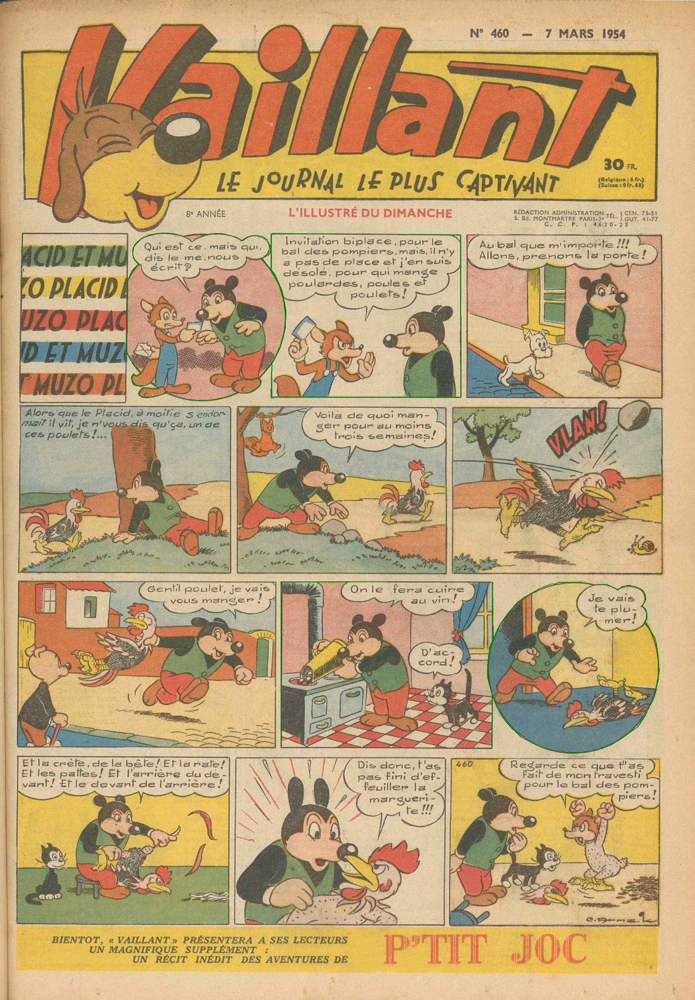

In [26]:
image = Image.open(sample["file_name"])
visualize_sample_anns(image, metadata, category_id=24) # panels

## Visualize Model Outputs

In [77]:
print(coco_metadata)
print(metadata)

Metadata(evaluator_type='coco_panoptic_seg', ignore_label=255, image_root='datasets/coco/val2017', json_file='datasets/coco/annotations/instances_val2017.json', label_divisor=1000, name='coco_2017_val_panoptic', panoptic_json='datasets/coco/annotations/panoptic_val2017.json', panoptic_root='datasets/coco/panoptic_val2017', stuff_classes=['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toil

In [70]:
# Show panoptic/instance/semantic predictions:
im = cv2.imread(sample["file_name"])
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1], coco_metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
panoptic_result = v.draw_panoptic_seg(outputs["panoptic_seg"][0].to("cpu"), outputs["panoptic_seg"][1]).get_image()
v = Visualizer(im[:, :, ::-1], coco_metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
instance_result = v.draw_instance_predictions(outputs["instances"].to("cpu")).get_image()
v = Visualizer(im[:, :, ::-1], coco_metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
semantic_result = v.draw_sem_seg(outputs["sem_seg"].argmax(0).to("cpu")).get_image()
print("Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)")
res = np.concatenate((panoptic_result, instance_result, semantic_result), axis=0)[:, :, ::-1]

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)


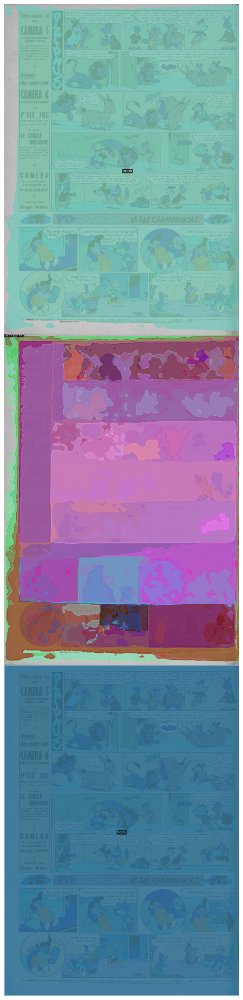

In [72]:
plt.figure(figsize=(40, 30))
plt.imshow(res)
plt.axis('off')
plt.show()

In [91]:
for ann in sample["annotations"]:
    if 'segmentation' not in ann:
        x, y, w, h = ann['bbox']
        ann['segmentation'] = [[x, y, x+w, y+h]]

In [94]:
for x, y in class_id2color.items():
    class_id2color[x] = [p / 225 for p in y]

In [100]:
class_id2color

{1: [57, 51, 58],
 2: [184, 61, 245],
 3: [204, 51, 102],
 4: [204, 153, 51],
 5: [250, 250, 55],
 6: [159, 165, 161],
 7: [0, 0, 255],
 8: [170, 240, 209],
 9: [240, 120, 240],
 10: [73, 144, 180],
 11: [204, 153, 51],
 12: [34, 127, 69],
 13: [190, 178, 146],
 14: [155, 121, 22],
 15: [253, 218, 113],
 16: [255, 204, 51],
 17: [50, 183, 250],
 18: [102, 255, 102],
 19: [184, 61, 245],
 20: [51, 221, 255],
 21: [145, 160, 70],
 22: [13, 44, 25],
 23: [18, 240, 101],
 24: [210, 212, 134],
 25: [52, 209, 183],
 26: [36, 179, 83],
 27: [178, 80, 80],
 28: [255, 204, 51]}

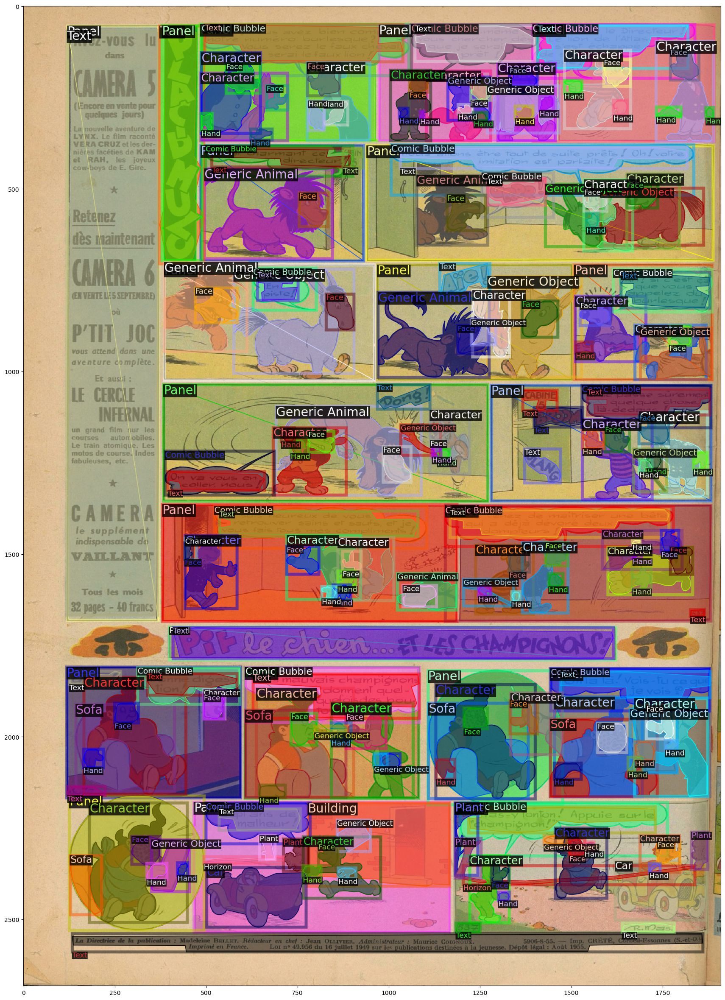

In [120]:
v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.SEGMENTATION)
r = v.draw_dataset_dict(sample).get_image()
plt.figure(figsize=(30,30))
plt.imshow(r)

In [106]:
im = cv2.imread(sample["file_name"])
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
instance_result = v.overlay_instances(
    masks=[ann["segmentation"] for ann in sample["annotations"]],
    boxes=[ann["bbox"] for ann in sample["annotations"]],
    labels=[ann["category_id"] for ann in sample["annotations"]],
    assigned_colors=['r' for ann in sample['annotations']]
).get_image()

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

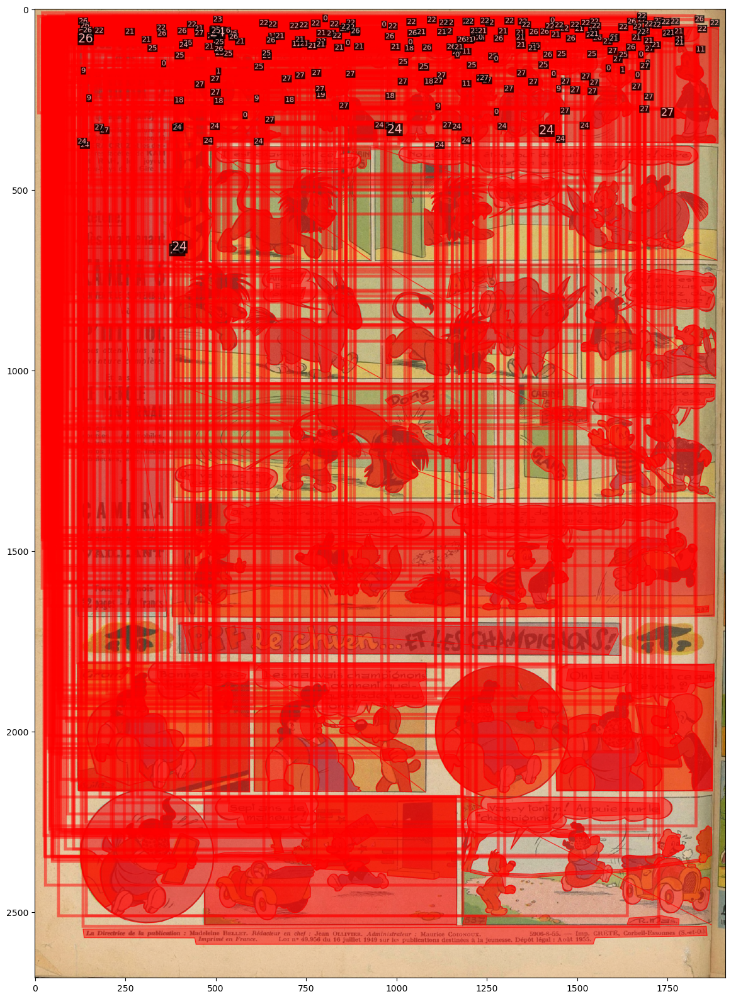

In [110]:
plt.figure(figsize=(20, 20))
plt.imshow(instance_result.get_image())
plt.show()

# Evaluation

In [ ]:
import torch
import numpy as np
import pycocotools.mask as mask_util
from tqdm import tqdm
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode
from detectron2.engine.defaults import DefaultPredictor
from detectron2.evaluation import DatasetEvaluator

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
class CustomEvaluator(DatasetEvaluator):
    def __init__(self, dataset_name):
        self._dataset_name = dataset_name
        self._predictions = []

    def reset(self):
        self._predictions = []

    def process(self, inputs, outputs):
        for inp, output in zip(inputs, outputs):
            image_id = inp["image_id"]
            scores = output.scores.cpu().numpy()
            pred_classes = output.pred_classes.cpu().numpy()
            pred_masks = output.pred_masks.cpu().numpy()

            for score, pred_class, pred_mask in zip(scores, pred_classes, pred_masks):
                prediction = {
                    "image_id": image_id,
                    "pred_class": pred_class,
                    "pred_mask": pred_mask,
                    "score": score,
                    "file_name": inp["file_name"],
                    "height": inp["height"],
                    "width": inp["width"],
                    "annotations": inp["annotations"]
                }
                self._predictions.append(prediction)

    def evaluate(self):
        return self._predictions

In [ ]:
instance_evaluator = CustomEvaluator(dataset_name)

In [ ]:
# instance segmentation

for d in tqdm(dataset_dicts):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    instance_evaluator.process([d], [outputs["instances"]])

In [ ]:
results = instance_evaluator.evaluate()
results[0]

In [ ]:
# Function to convert coco format segmentation to binary masks
def coco_segmentation_to_mask(segmentation, height, width):
    binary_mask = mask_util.frPyObjects(segmentation, height, width)
    binary_mask = mask_util.decode(binary_mask)
    return binary_mask

# Function to compute IoU between two binary masks
def compute_iou(predicted_mask, target_mask):
    intersection = np.logical_and(predicted_mask, target_mask).sum()
    union = np.logical_or(predicted_mask, target_mask).sum()
    iou = intersection / (union + 1e-6)  # Add a small epsilon to avoid division by zero
    return iou

# Function to evaluate the model on the dataset
def evaluate_model_on_dataset(results):
    iou_per_class = {class_id: [] for class_id in metadata.get("thing_classes")}
    iou_per_class.update({'None': []})

    for result in tqdm(results):
        height = result["height"]
        width = result["width"]
        annotations = result["annotations"]
        class_id = result["pred_class"]
        predicted_mask = result["pred_mask"]
        score = result["score"]

        target_masks = [
            coco_segmentation_to_mask(ann["segmentation"], height, width)
            for ann in annotations if 'segmentation' in ann
        ]

        target_classes = [ann["category_id"] for ann in annotations]
        if class_id in iou_per_class:
            target_mask = target_masks[target_classes.index(class_id)].squeeze(axis=-1)
            iou = compute_iou(predicted_mask, target_mask)
            iou_per_class[class_id].append((score, iou))

    # Calculate the mean IoU per class
    mean_iou_per_class = {}
    for class_id, iou_list in iou_per_class.items():
        if len(iou_list):
            scores, ious = zip(*iou_list)
            mean_iou_per_class[class_id] = np.mean(ious)

    return mean_iou_per_class

In [ ]:
# Evaluating the model on the given dataset
mean_iou_per_class = evaluate_model_on_dataset(results)

# Print or store the mean IoU per class
print("Mean IoU per class:")
print(mean_iou_per_class)